In [1]:
import os
import torch

from base64 import b64encode
from cotracker.utils.visualizer import Visualizer, read_video_from_path
from IPython.display import HTML

In [2]:
!git clone https://github.com/facebookresearch/co-tracker
%cd co-tracker
!pip install -e .
!pip install opencv-python matplotlib moviepy flow_vis
!mkdir checkpoints
%cd checkpoints
!wget https://huggingface.co/facebook/cotracker3/resolve/main/scaled_offline.pth

Cloning into 'co-tracker'...
remote: Enumerating objects: 447, done.
remote: Counting objects: 100% (273/273), done.
remote: Compressing objects: 100% (144/144), done.
remote: Total 447 (delta 204), reused 129 (delta 129), pack-reused 174 (from 2)
Receiving objects: 100% (447/447), 64.52 MiB | 12.08 MiB/s, done.
Resolving deltas: 100% (245/245), done.
/Users/mrinalraj/Downloads/WebDownload/Driving48/co-tracker


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


Obtaining file:///Users/mrinalraj/Downloads/WebDownload/Driving48/co-tracker
  Preparing metadata (setup.py) ... done
  Attempting uninstall: cotracker
    Found existing installation: cotracker 3.0
    Uninstalling cotracker-3.0:
      Successfully uninstalled cotracker-3.0
  DEPRECATION: Legacy editable install of cotracker==3.0 from file:///Users/mrinalraj/Downloads/WebDownload/Driving48/co-tracker (setup.py develop) is deprecated. pip 25.3 will enforce this behaviour change. A possible replacement is to add a pyproject.toml or enable --use-pep517, and use setuptools >= 64. If the resulting installation is not behaving as expected, try using --config-settings editable_mode=compat. Please consult the setuptools documentation for more information. Discussion can be found at https://github.com/pypa/pip/issues/11457
  Running setup.py develop for cotracker
/Users/mrinalraj/Downloads/WebDownload/Driving48/co-tracker/checkpoints
--2025-07-09 15:01:50--  https://huggingface.co/facebook/cot

In [58]:

video = read_video_from_path('/Users/mrinalraj/Downloads/WebDownload/Driving48/rgb/LkluZoNfKu8_00071.mp4')
video = torch.from_numpy(video).permute(0, 3, 1, 2)[None].float()

In [59]:
from cotracker.predictor import CoTrackerPredictor

model = CoTrackerPredictor(
    checkpoint = './scaled_offline.pth'
)

FileNotFoundError: [Errno 2] No such file or directory: './scaled_offline.pth'

In [60]:
pred_tracks, pred_visibility = model(video, grid_size=30)

In [10]:
vis = Visualizer(save_dir='./videos', pad_value=100)
vis.visualize(video=video, tracks=pred_tracks, visibility=pred_visibility, filename='teaser');

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (840, 680) to (848, 688) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


Video saved to ./videos/teaser.mp4


In [11]:
def show_video(video_path):
    video_file = open(video_path, "r+b").read()
    video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
    return HTML(f"""<video width="640" height="480" autoplay loop controls><source src="{video_url}"></video>""")
 
show_video("./videos/teaser.mp4")

In [26]:
queries = torch.tensor([
    [0., 300., 160.],  # point tracked from the first frame
    [10., 600., 500.], # frame number 10
    [20., 750., 600.], # ...
    [30., 900., 200.]
])
if torch.cuda.is_available():
    queries = queries.cuda()

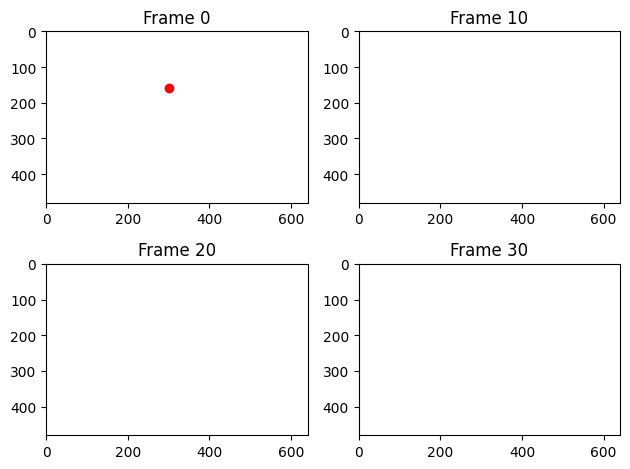

In [27]:
import matplotlib.pyplot as plt
# Create a list of frame numbers corresponding to each point
frame_numbers = queries[:,0].int().tolist()

fig, axs = plt.subplots(2, 2)
axs = axs.flatten()

for i, (query, frame_number) in enumerate(zip(queries, frame_numbers)):
    ax = axs[i]
    ax.plot(query[1].item(), query[2].item(), 'ro') 
    
    ax.set_title("Frame {}".format(frame_number))
    ax.set_xlim(0, video.shape[4])
    ax.set_ylim(0, video.shape[3])
    ax.invert_yaxis()
    
plt.tight_layout()
plt.show()

In [28]:
pred_tracks, pred_visibility = model(video, queries=queries[None])

In [29]:
vis = Visualizer(
    save_dir='./videos',
    linewidth=6,
    mode='cool',
    tracks_leave_trace=-1
)
vis.visualize(
    video=video,
    tracks=pred_tracks,
    visibility=pred_visibility,
    filename='queries');

Video saved to ./videos/queries.mp4


In [30]:
video.shape

torch.Size([1, 76, 3, 480, 640])

(480, 640, 3)
(384, 512, 3)

0: 288x384 2 persons, 79.0ms
Speed: 0.8ms preprocess, 79.0ms inference, 0.5ms postprocess per image at shape (1, 3, 288, 384)


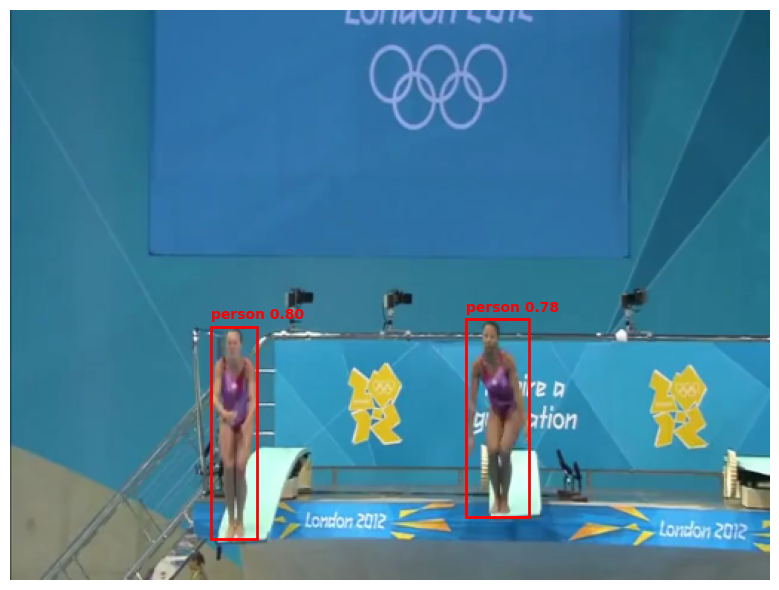

In [66]:
import cv2
import torch
import matplotlib.pyplot as plt
from torchvision import transforms
from ultralytics import YOLO  # from ultralytics/yolov8

def process_video_first_frame(video_path):
    # Load the video
    cap = cv2.VideoCapture(video_path)
    cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
    success, frame = cap.read()
    cap.release()

    if not success:
        raise ValueError("Failed to read the video.")
    print(frame.shape)
    # Resize to 480x640
    frame_resized = cv2.resize(frame, (512, 384) )

    # Convert BGR (OpenCV) to RGB
    frame_rgb = cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB)
    print(frame_rgb.shape)
    model = YOLO('yolov8x.pt')  # or yolov5s.pt if you use YOLOv5
    results = model.predict(source=frame_resized, imgsz=[512, 384], conf=0.3, save=False, show=False)

    # Plot with matplotlib
    fig, ax = plt.subplots(1, 1, figsize=(10, 6))
    ax.imshow(frame_rgb)
    for r in results:
        boxes = r.boxes
        if boxes is not None:
            for box in boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                cls_id = int(box.cls[0])
                conf = float(box.conf[0])
                label = f"{model.names[cls_id]} {conf:.2f}"
                rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                     edgecolor='red', facecolor='none', linewidth=2)
                ax.add_patch(rect)
                ax.text(x1, y1 - 5, label, color='red', fontsize=10, weight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

    return frame_rgb

# Example usage
frame_tensor = process_video_first_frame('/Users/mrinalraj/Downloads/WebDownload/Driving48/rgb/_lmT4WlK7G0_00047.mp4')

sk8TafuB3lU_00134.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 14 persons, 3 chairs, 176.1ms
Speed: 0.6ms preprocess, 176.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


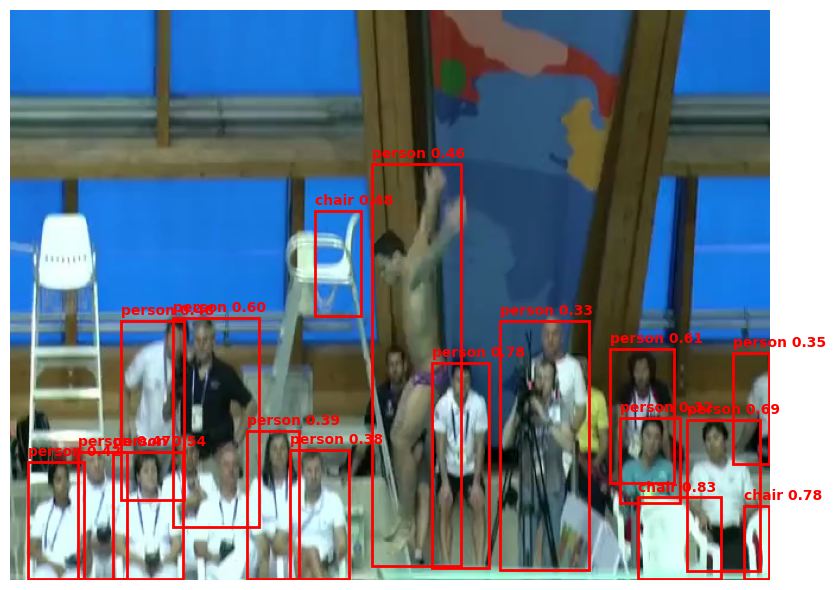

9BC6ssCjyfg_00174.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 169.7ms
Speed: 0.6ms preprocess, 169.7ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


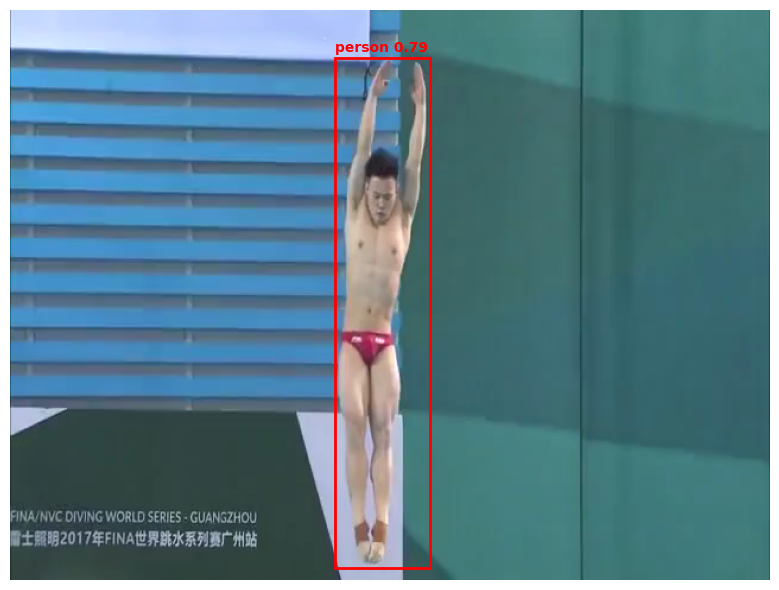

jMEYIEYkpY0_00112.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 1 bird, 186.9ms
Speed: 1.6ms preprocess, 186.9ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


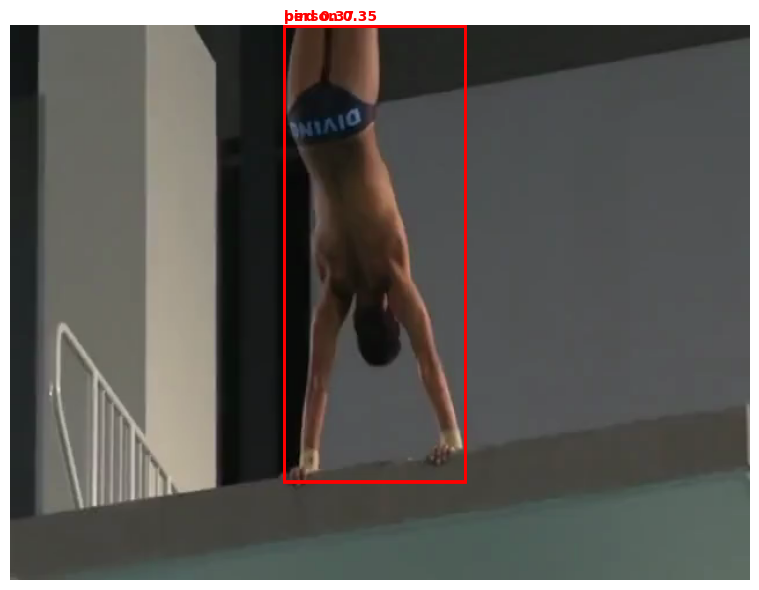

vlfy4cny75s_00142.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 177.8ms
Speed: 1.6ms preprocess, 177.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


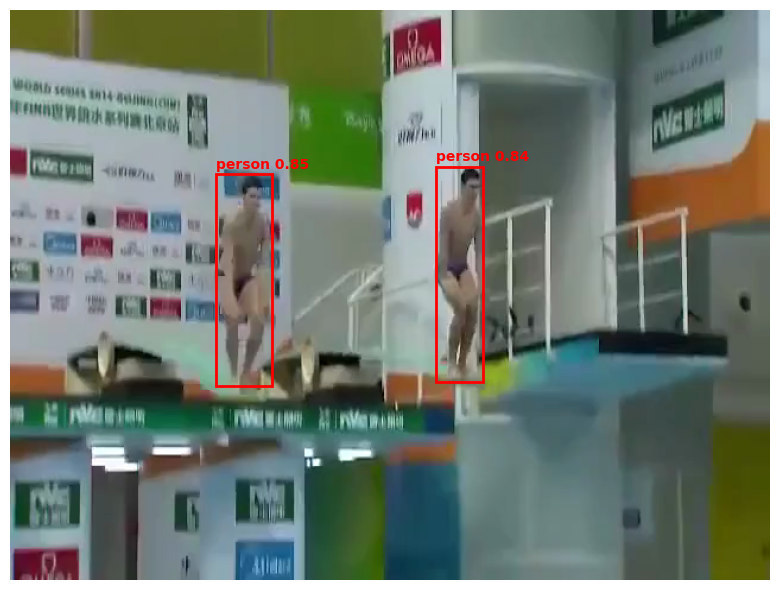

sRA_iEJGHtU_00003.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 165.6ms
Speed: 0.6ms preprocess, 165.6ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


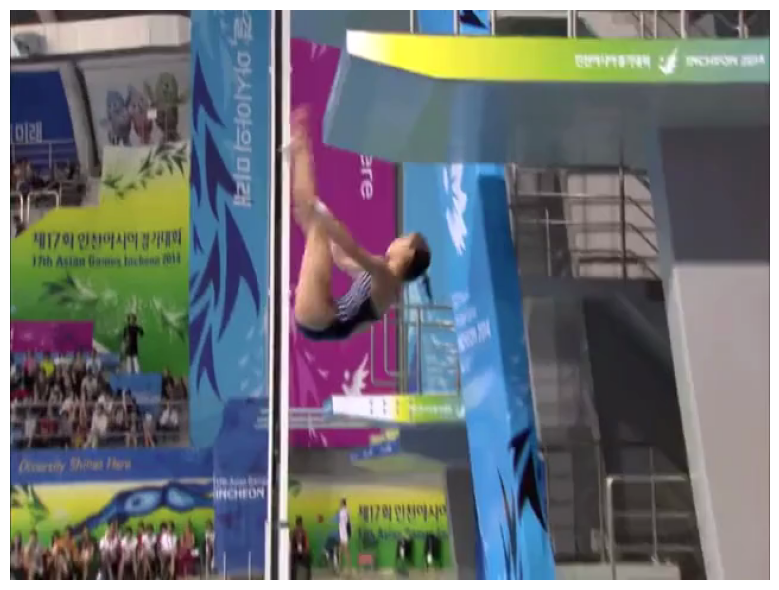

_tigfCJFLZg_00117.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 166.9ms
Speed: 0.5ms preprocess, 166.9ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


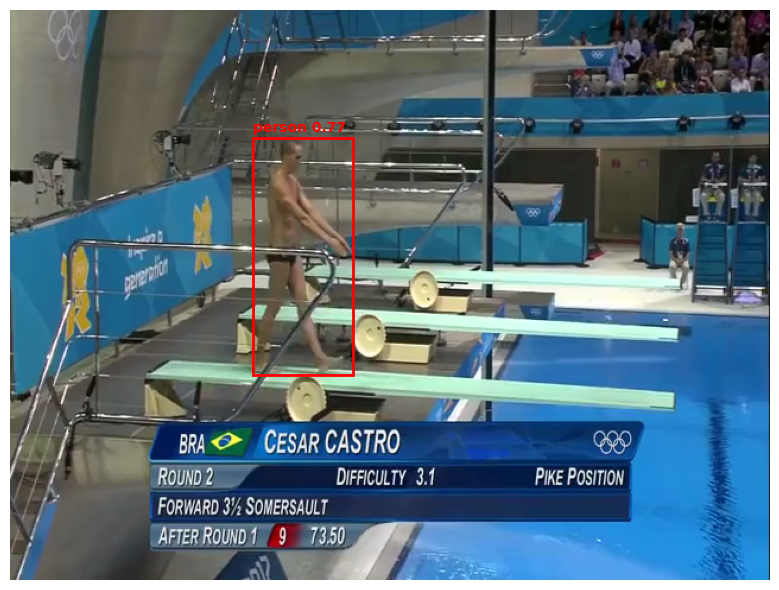

_lmT4WlK7G0_00047.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 1 toothbrush, 170.8ms
Speed: 0.5ms preprocess, 170.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


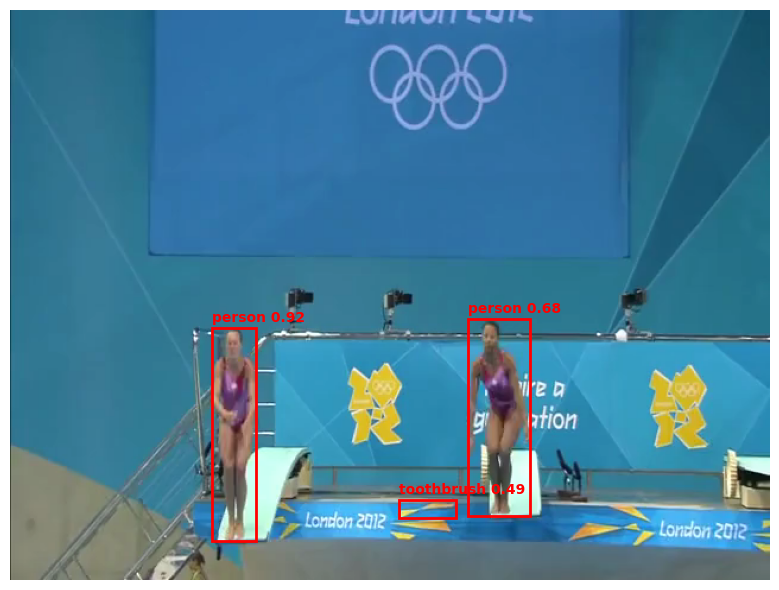

LkluZoNfKu8_00071.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 5 persons, 170.8ms
Speed: 0.8ms preprocess, 170.8ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


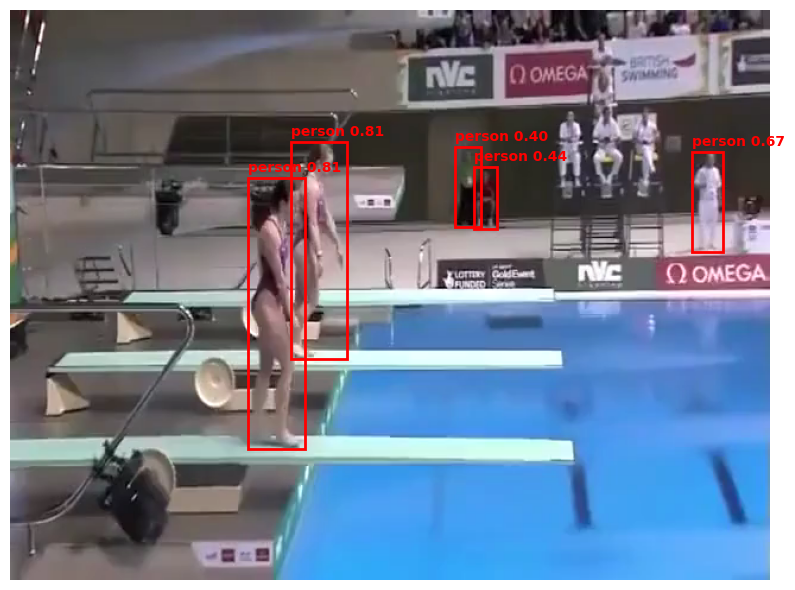

JzOshOJgofw_00117.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 5 persons, 1 chair, 166.8ms
Speed: 0.6ms preprocess, 166.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


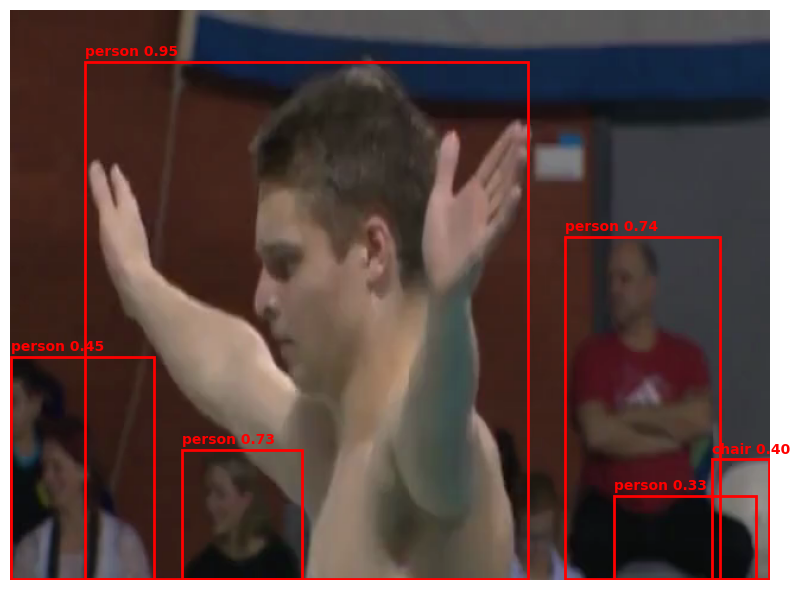

sexZ6VnZ9yc_00030.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 8 persons, 7 chairs, 174.3ms
Speed: 1.3ms preprocess, 174.3ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


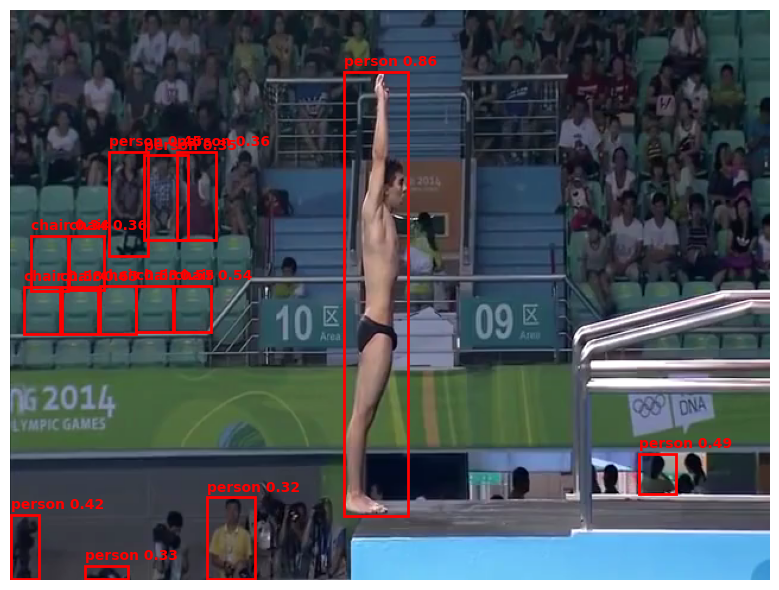

uDESPUxbjnI_00144.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 167.4ms
Speed: 1.0ms preprocess, 167.4ms inference, 0.2ms postprocess per image at shape (1, 3, 480, 640)


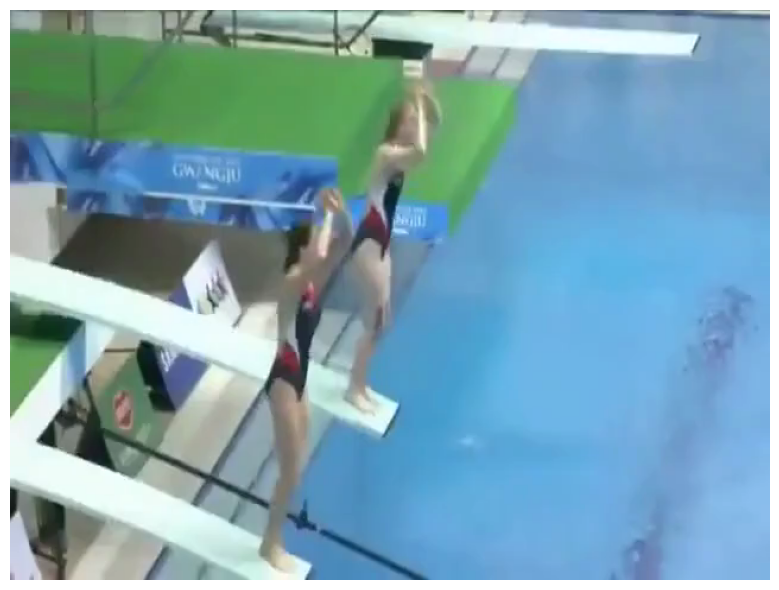

Y7QZcr24ye0_00823.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 182.3ms
Speed: 0.5ms preprocess, 182.3ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


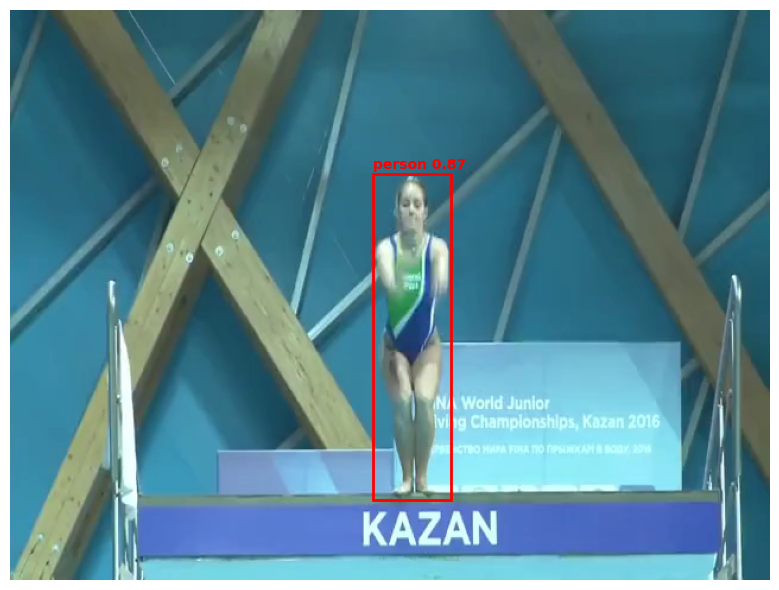

c7FHotPDZIw_00111.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 11 persons, 5 chairs, 1 laptop, 179.7ms
Speed: 0.6ms preprocess, 179.7ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


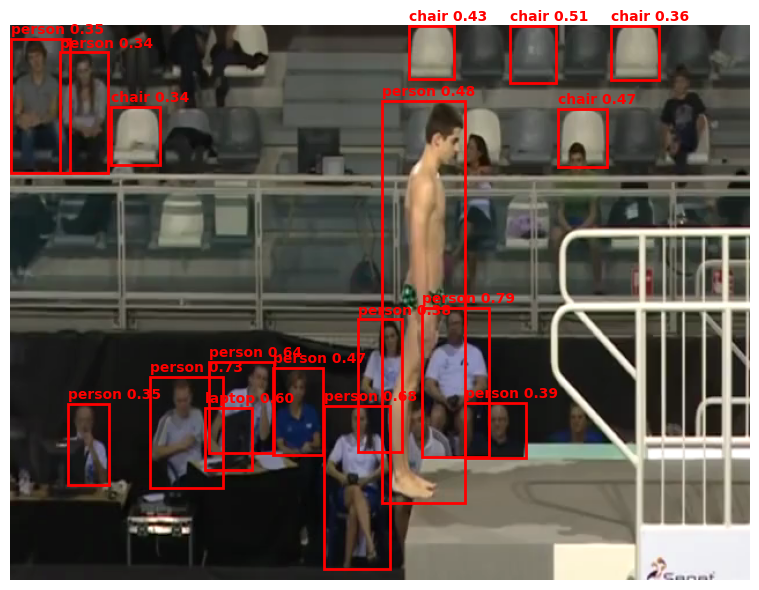

D6zILEKIJbk_00251.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 8 persons, 5 chairs, 173.3ms
Speed: 0.6ms preprocess, 173.3ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


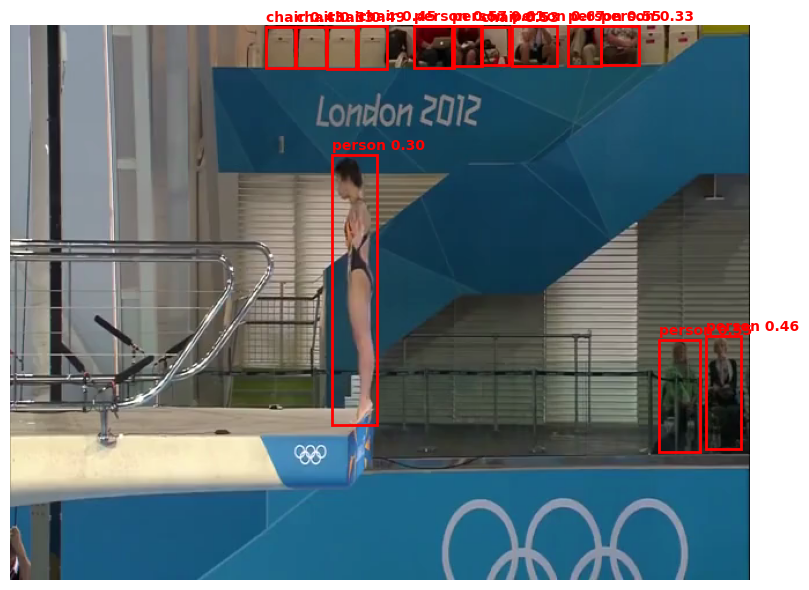

3PLiUG_DuC8_00110.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 1 remote, 1 sink, 176.8ms
Speed: 0.5ms preprocess, 176.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


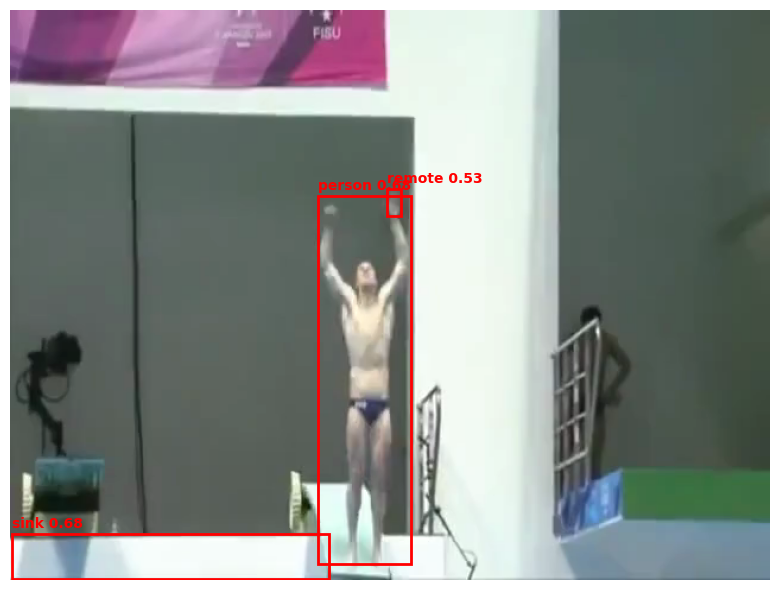

sk8TafuB3lU_00652.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 5 persons, 169.7ms
Speed: 0.5ms preprocess, 169.7ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


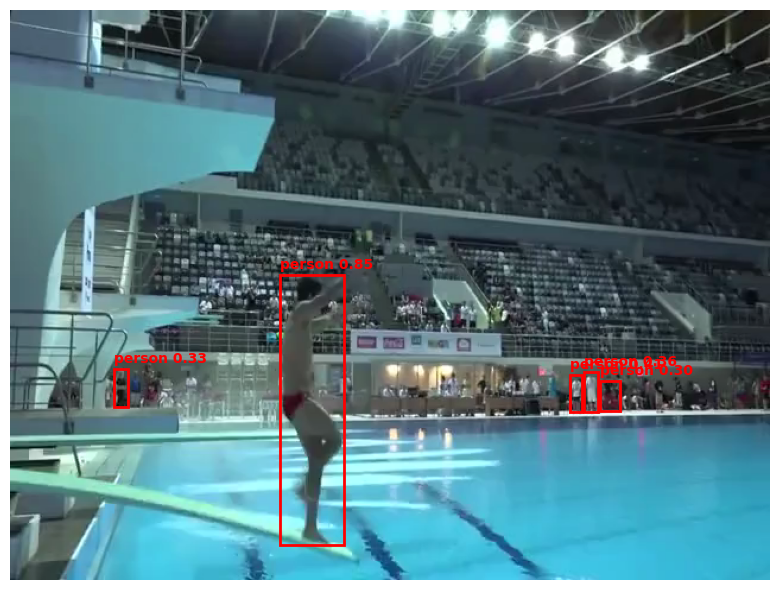

TMJ1XIZBRW4_00016.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 7 persons, 12 chairs, 167.1ms
Speed: 0.5ms preprocess, 167.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


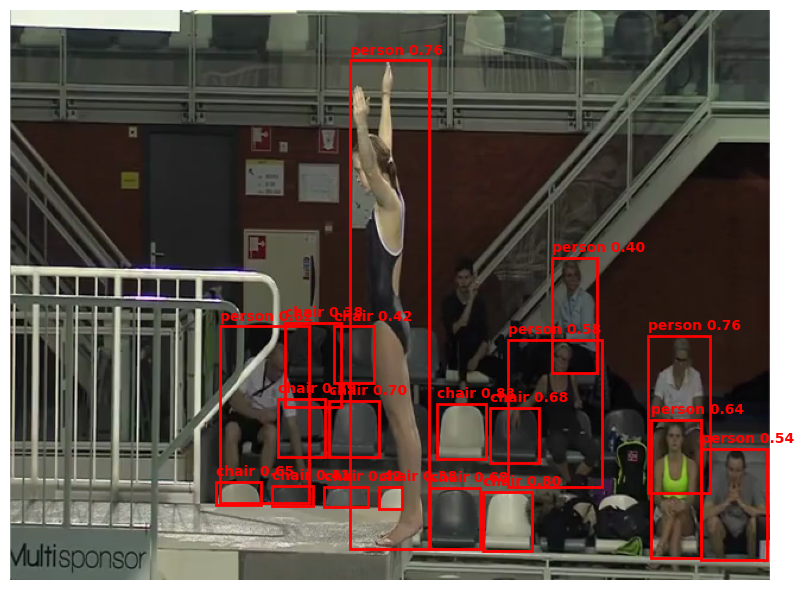

V5parOfpuEQ_00079.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 168.5ms
Speed: 0.6ms preprocess, 168.5ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


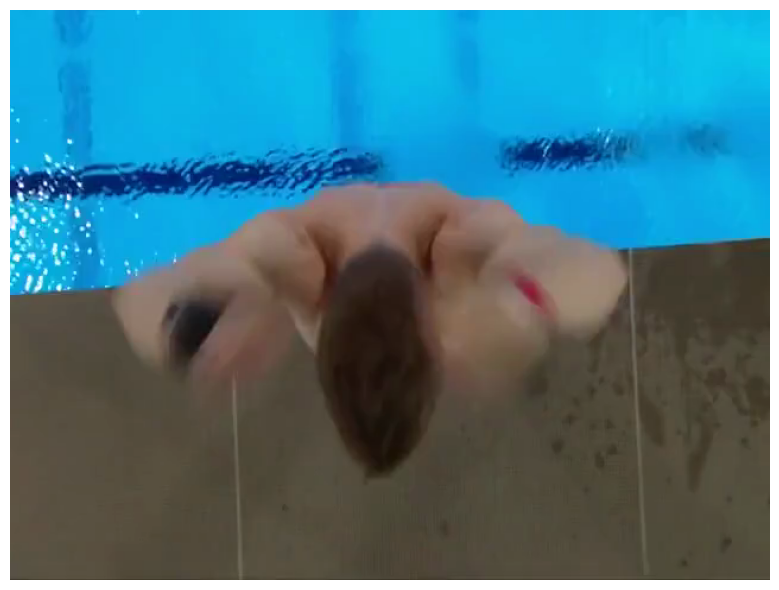

Y7QZcr24ye0_00837.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 1 scissors, 167.9ms
Speed: 0.6ms preprocess, 167.9ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


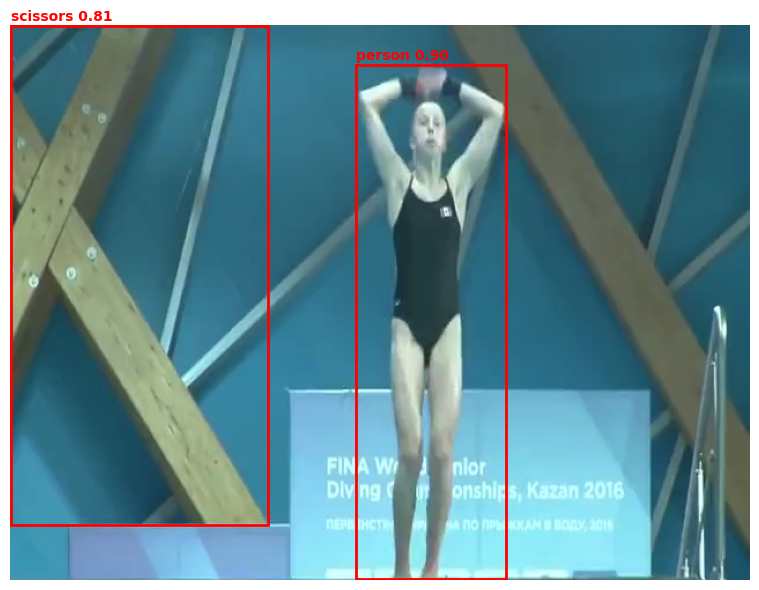

D6zILEKIJbk_00245.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 4 chairs, 169.2ms
Speed: 0.6ms preprocess, 169.2ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


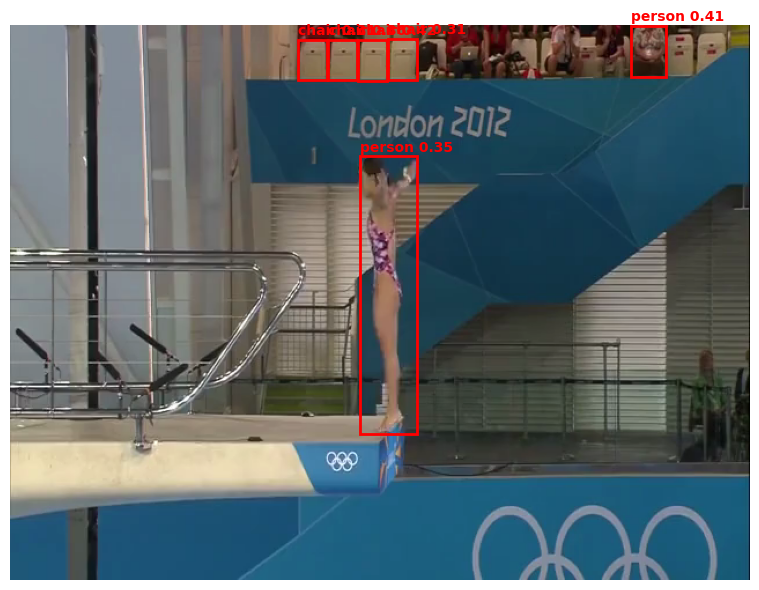

c7FHotPDZIw_00105.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 169.9ms
Speed: 0.6ms preprocess, 169.9ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


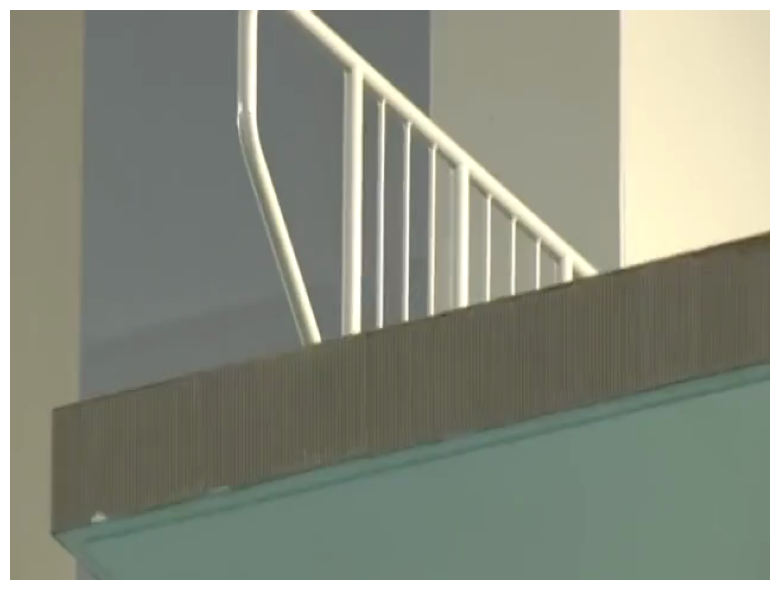

3PLiUG_DuC8_00104.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 169.2ms
Speed: 0.6ms preprocess, 169.2ms inference, 0.2ms postprocess per image at shape (1, 3, 480, 640)


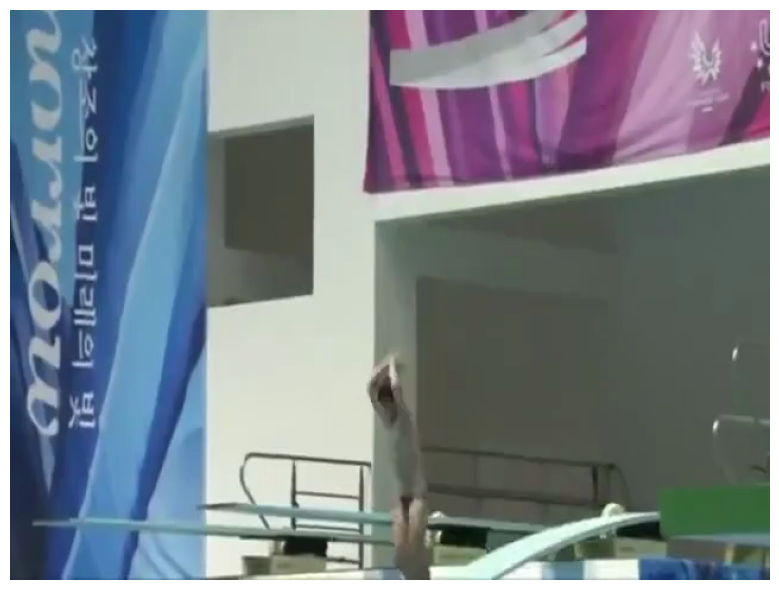

sk8TafuB3lU_00646.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 horse, 166.9ms
Speed: 0.5ms preprocess, 166.9ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


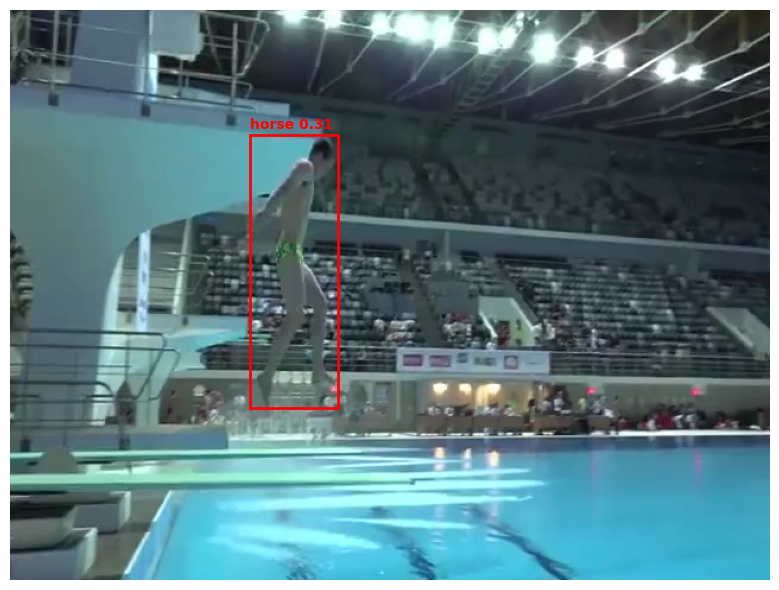

db7DmpqzGmc_00208.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 3 persons, 171.5ms
Speed: 0.6ms preprocess, 171.5ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


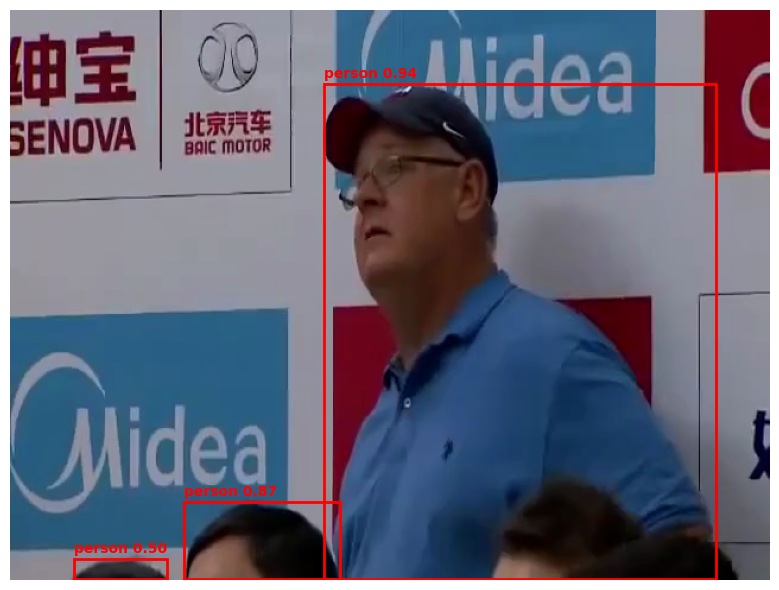

TMJ1XIZBRW4_00002.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 169.1ms
Speed: 0.8ms preprocess, 169.1ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


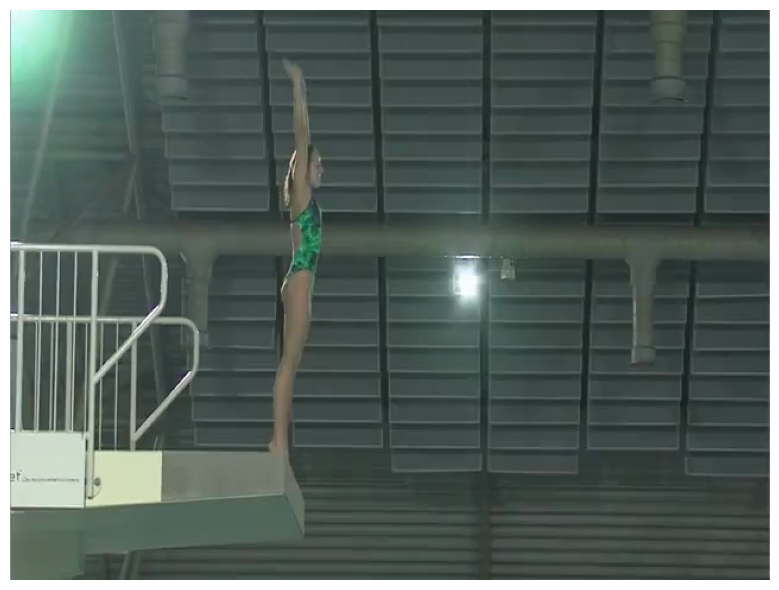

_tigfCJFLZg_00103.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 168.8ms
Speed: 0.6ms preprocess, 168.8ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


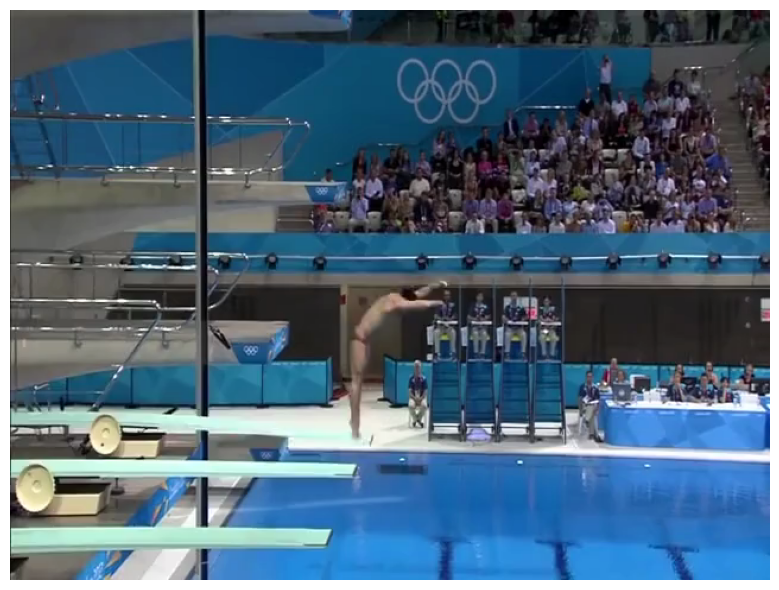

JzOshOJgofw_00103.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 3 persons, 170.7ms
Speed: 0.5ms preprocess, 170.7ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


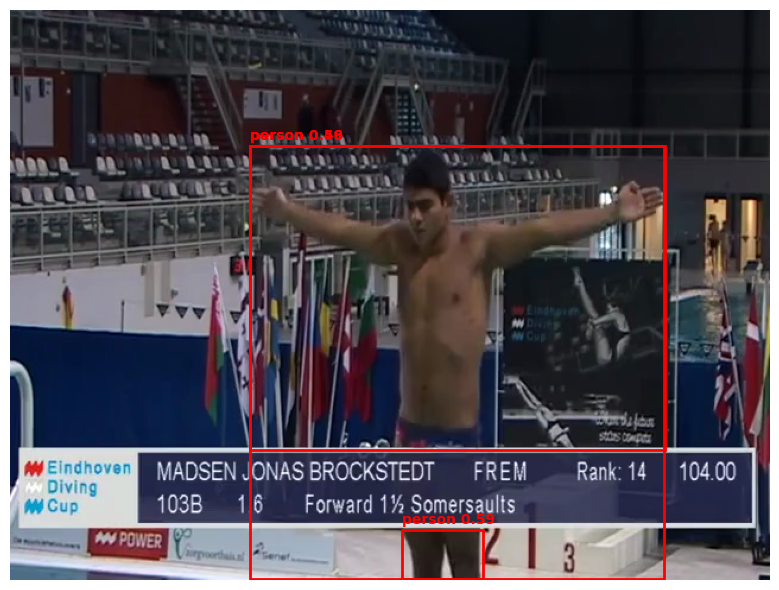

LkluZoNfKu8_00065.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 7 persons, 168.4ms
Speed: 0.6ms preprocess, 168.4ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


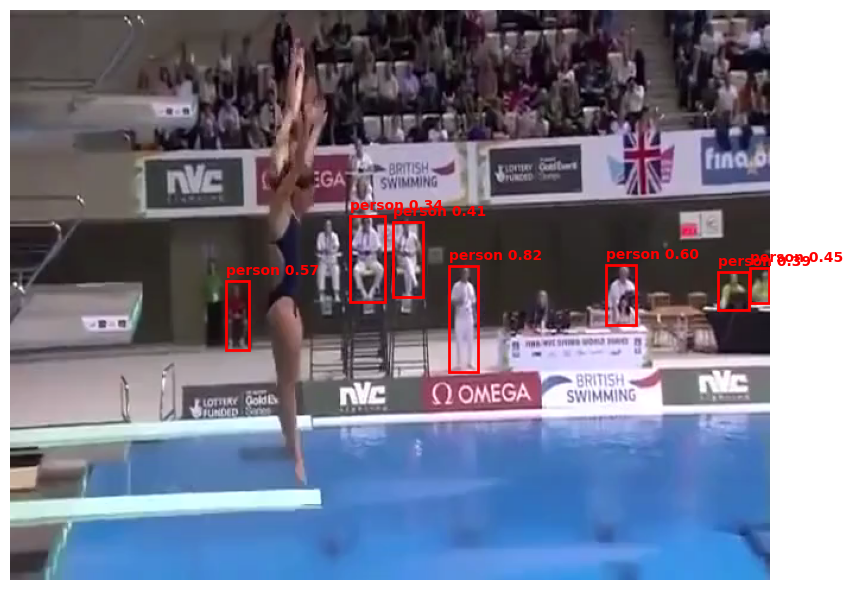

_lmT4WlK7G0_00053.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 168.0ms
Speed: 0.5ms preprocess, 168.0ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


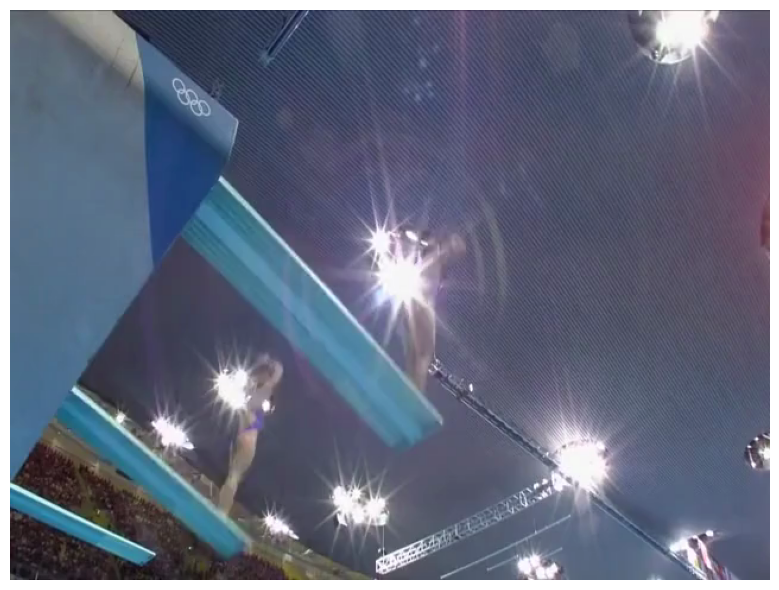

sexZ6VnZ9yc_00024.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 4 persons, 11 chairs, 169.9ms
Speed: 0.6ms preprocess, 169.9ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


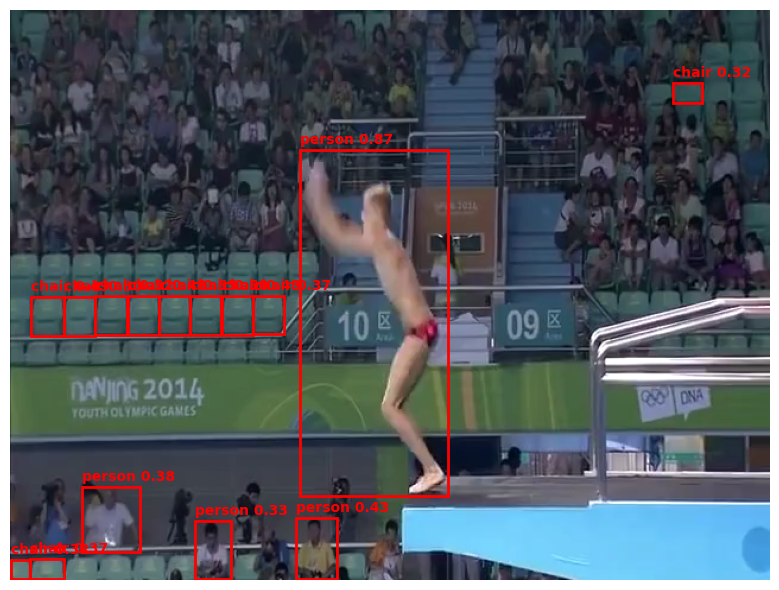

Y4ARBzok9aU_00029.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 1 tv, 170.1ms
Speed: 0.5ms preprocess, 170.1ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


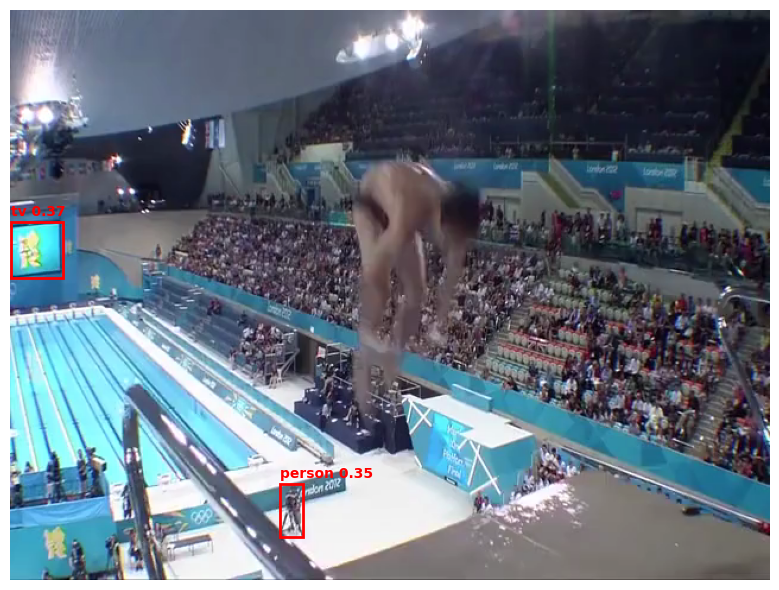

uDESPUxbjnI_00150.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 182.0ms
Speed: 0.5ms preprocess, 182.0ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


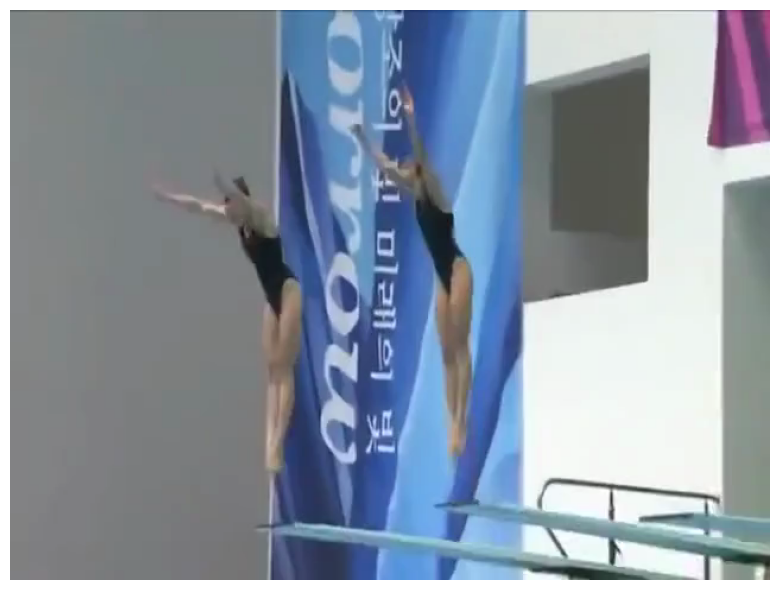

vlfy4cny75s_00156.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 187.0ms
Speed: 0.7ms preprocess, 187.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


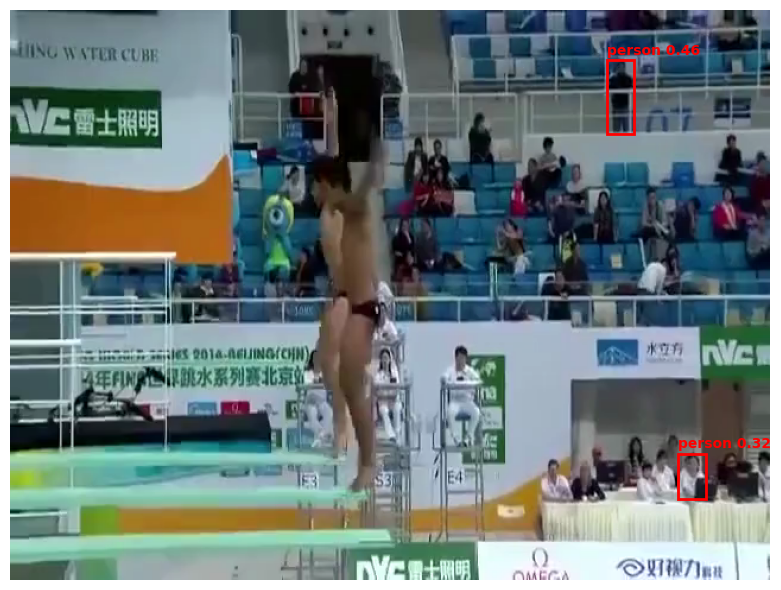

jMEYIEYkpY0_00106.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 175.9ms
Speed: 0.5ms preprocess, 175.9ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


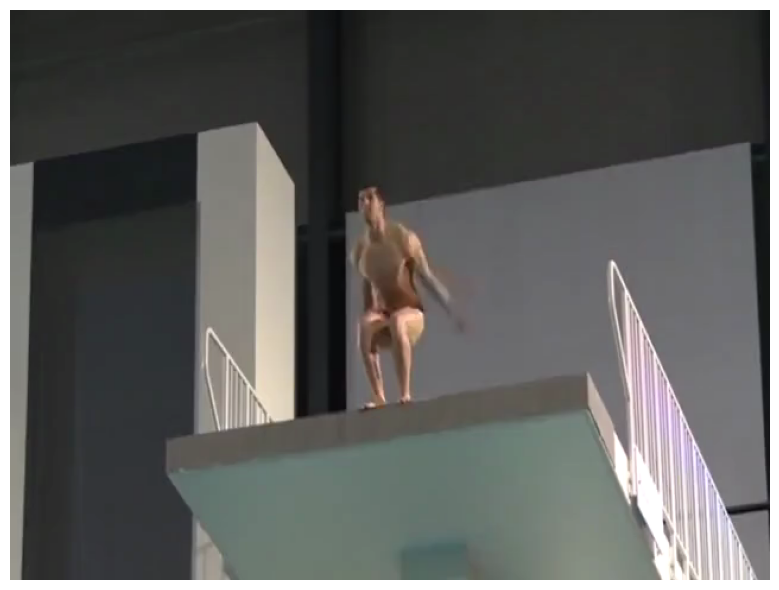

sk8TafuB3lU_00120.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 12 persons, 1 chair, 171.2ms
Speed: 0.6ms preprocess, 171.2ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


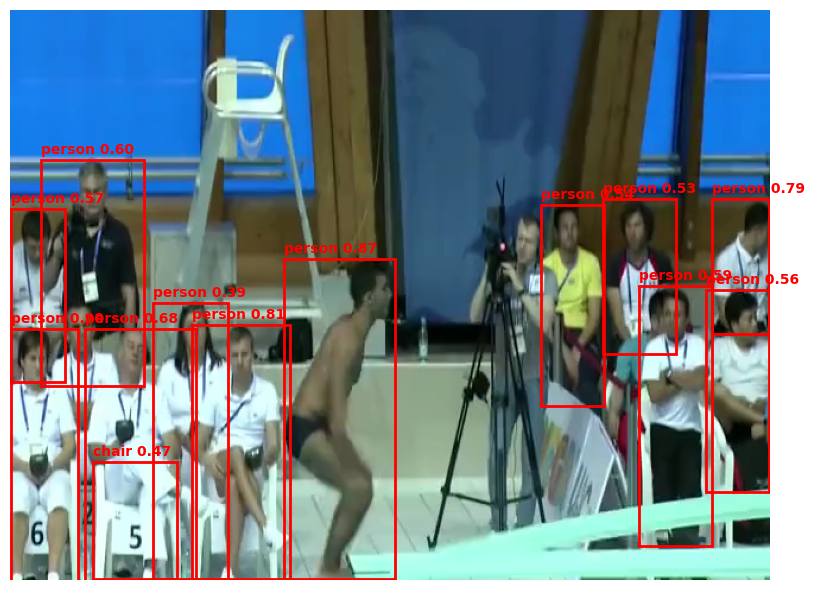

Y7QZcr24ye0_00189.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 176.4ms
Speed: 0.5ms preprocess, 176.4ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


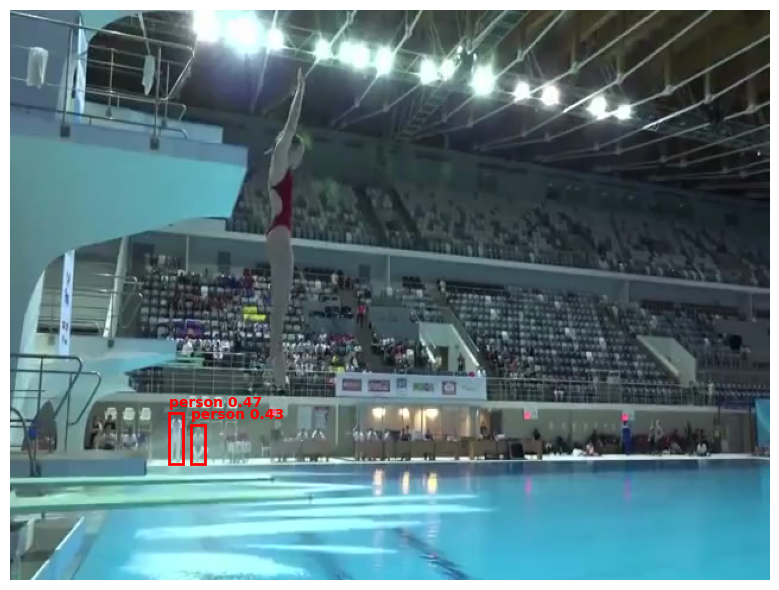

aektxm8cLdo_00040.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 (no detections), 171.4ms
Speed: 0.5ms preprocess, 171.4ms inference, 0.3ms postprocess per image at shape (1, 3, 480, 640)


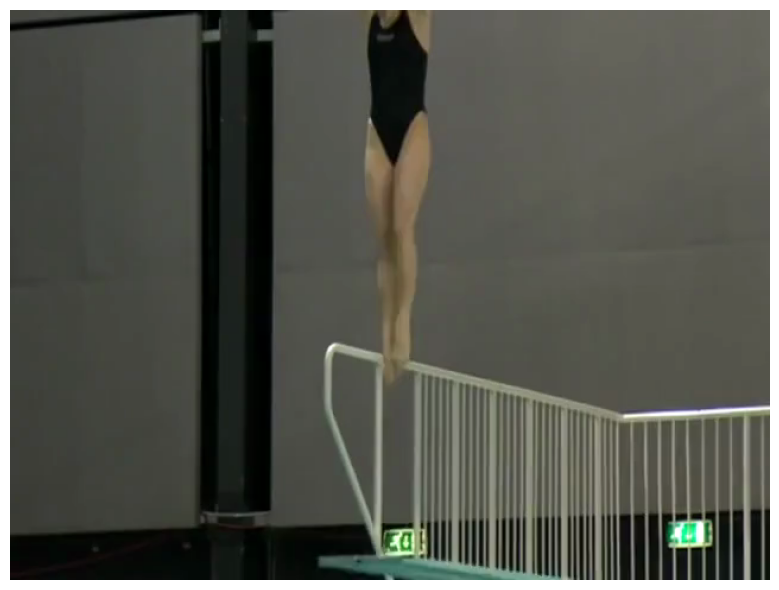

9BC6ssCjyfg_00160.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 172.6ms
Speed: 0.5ms preprocess, 172.6ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


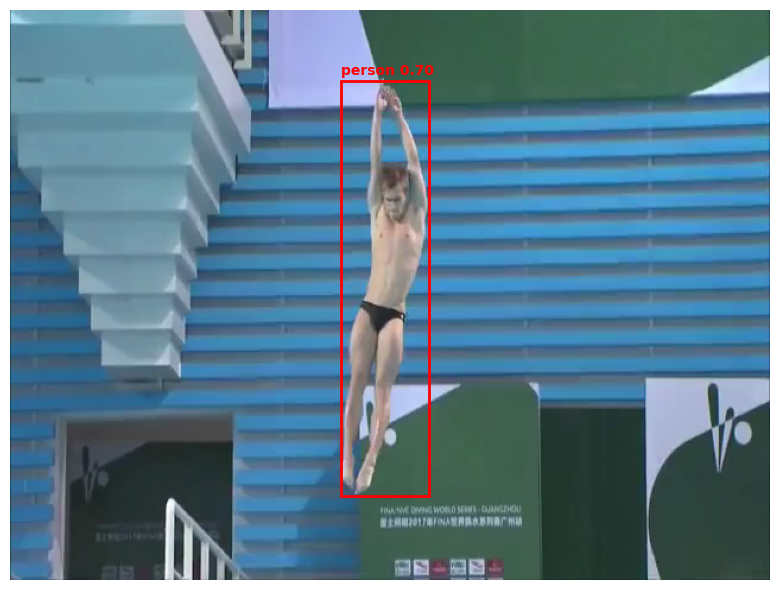

LNMISxO35S0_00239.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 1 tv, 1 scissors, 171.8ms
Speed: 0.6ms preprocess, 171.8ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


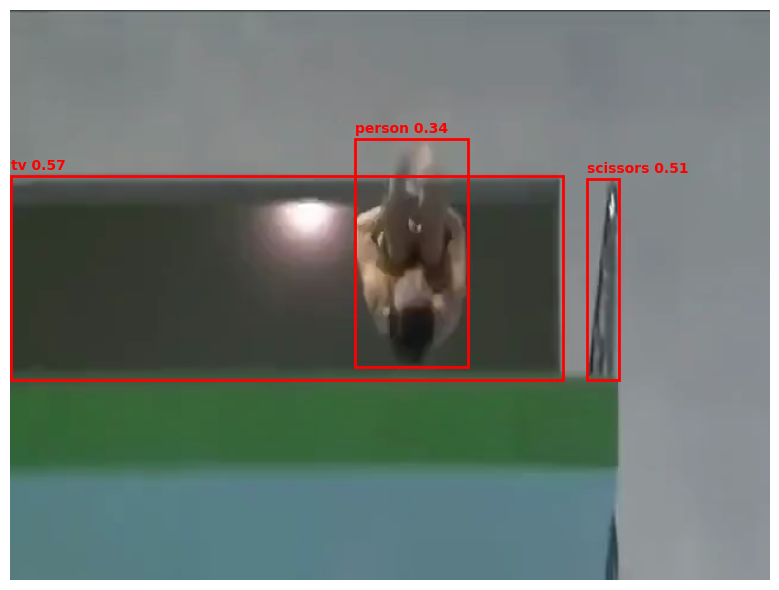

egsanPCCIzQ_00003.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 1 person, 169.2ms
Speed: 0.6ms preprocess, 169.2ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)


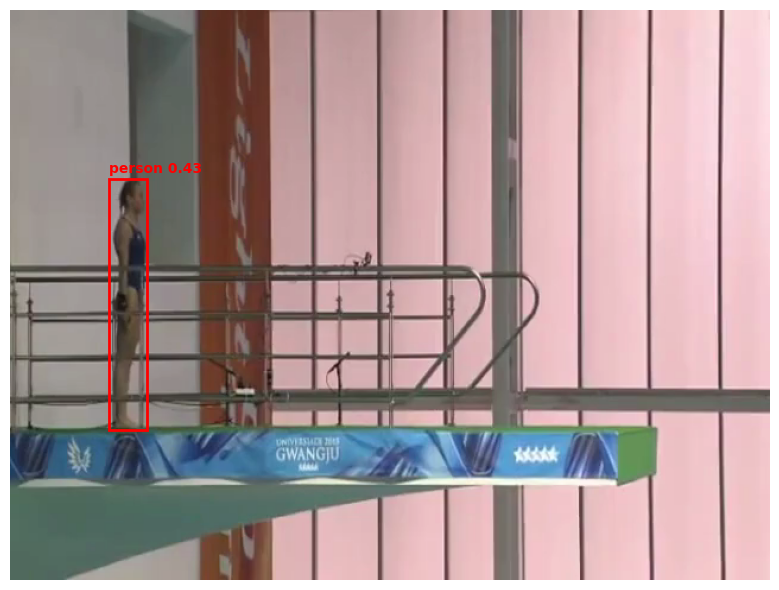

Le6xdQ2OO8w_00091.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 169.2ms
Speed: 0.6ms preprocess, 169.2ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


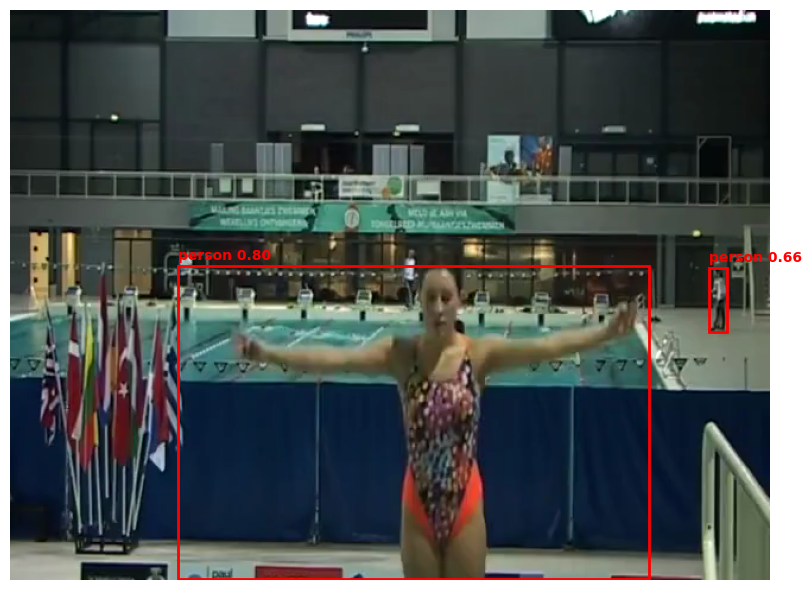

eN8umEok9U8_00195.mp4
(480, 640, 3)
(480, 640, 3)

0: 480x640 2 persons, 1 boat, 1 chair, 169.6ms
Speed: 0.6ms preprocess, 169.6ms inference, 0.4ms postprocess per image at shape (1, 3, 480, 640)


KeyboardInterrupt: 

In [57]:
for i in os.listdir("rgb/"):
    if i.endswith(".mp4"):
        print(i)
        process_video_first_frame(os.path.join("rgb",i))